As I've said [last time](http://www.clungu.com/tutorial/visualisation/Mapping/) we're going to do some visualization exercises by using `matplotlib` animation and some custom made charts.

During the first round of the presidential election, I've collected the attendance data (as was described [here](http://www.clungu.com/application/Getting-data-of-an-election/)) and I plan to use that as a source for creating two types of graphs:
* Bar chart race of some bucketed demographics
* Choropleth graphs of the attendance

Although the goal of this post is not draw hard conclusions about what these will show, some comments and interesting insight will be inlined. I'm sure though that a more careful look at these charts and graphs could yield more insights that I could offer so feel free to interpret them on your own.

# Bar chart race of demographics

## Bar charts race graphs

Bar chart races are a niche but not that new form of visualization techniques. They started being discussed more often after [Matt Navarra’s tweet](https://twitter.com/MattNavarra/status/1098580810062618627), which was viewed 10 million times. We then had [John Burn-Murdoch](https://twitter.com/jburnmurdoch/status/1107552367795412992)'s implementation in d3.js and [Pratap Vardhan](https://pratapvardhan.com/blog/bar-chart-race-python-matplotlib/)'s matplotlib implementation.

I'm going to do a derivate of Pretap's version since it doesn't involve other dependencies and is really well suited to a data scientist's tool box: `Python, Numpy, Pandas, Matplotlib`.

## Race of demographics

In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
from matplotlib import pyplot as plt

The dataset was already cleaned and aggregated beforehand. It consists of total votes for the following categories, taken throughout the day:
* 18-24, male / female
* 25-34, male / female
* 35-44, male / female
* 45-64, male / female
* 65+, male / female

In [35]:
df_by_age = pd.read_parquet("./_data/df_by_age.parquet")
df_by_age = df_by_age.reset_index()
df_by_age.head()

,hour,minute,second,Barbati 18-24,Barbati 25-34,Barbati 35-44,Barbati 45-64,Barbati 65+,Femei 18-24,Femei 25-34,Femei 35-44,Femei 45-64,Femei 65+
0,10,1,40,35901,93293.0,139520.0,343678.0,214137.0,35100.0,83519.0,111685.0,296501.0,197246.0
1,10,1,51,35901,93293.0,139520.0,343678.0,214137.0,35100.0,83519.0,111685.0,296501.0,197246.0
2,10,2,2,35901,93293.0,139520.0,343678.0,214137.0,35100.0,83519.0,111685.0,296501.0,197246.0
3,10,5,38,36629,94938.0,141966.0,351276.0,220240.0,35795.0,85116.0,113991.0,303835.0,203092.0
4,10,6,49,37136,96125.0,143825.0,356515.0,224211.0,36251.0,86249.0,115569.0,308857.0,207084.0


We're going to get a single row of data at a time and compile a single frame of the animation. These will be later tied together into a continuous one. 

In [95]:
def get_row(i):
    """
    Gets the data about a single row
    """
    hour, minute, second = df_by_age.iloc[i][['hour', 'minute', 'second']].astype(int).values
    _males = df_by_age.iloc[i][males].astype(int).values
    _females = df_by_age.iloc[i][females].astype(int).values
    return hour, minute, second, _males, _females

get_row(0)

(10,
 1,
 40,
 array([ 35901,  93293, 139520, 343678, 214137]),
 array([ 35100,  83519, 111685, 296501, 197246]))

Let's see how a single frame will look like:

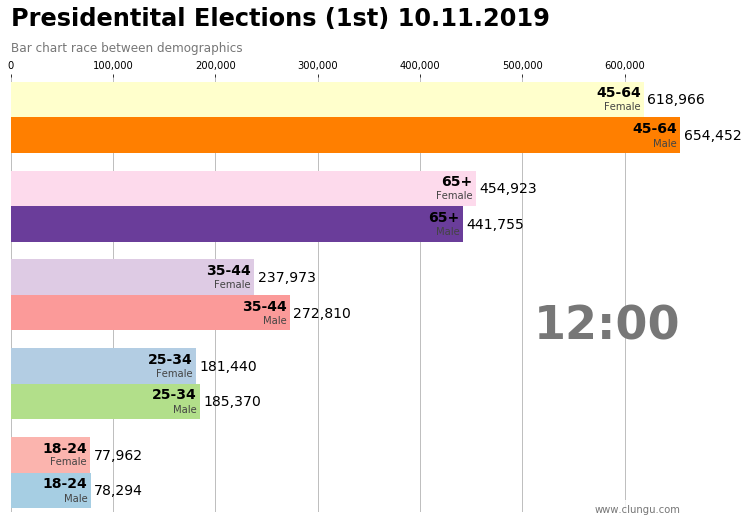

In [143]:
import matplotlib.ticker as ticker
from matplotlib.cm import get_cmap
from sklearn.preprocessing import normalize
from matplotlib.colors import Normalize
fig, ax = plt.subplots(figsize=(12, 8))

title = 'Presidentital Elections (1st) 10.11.2019'
subtitle = 'Bar chart race between demographics'

demographics = set(df_by_age.columns) - set(['hour', 'minute', 'second'])
males = np.array(sorted({category for category in demographics if "Barbati" in category}))
females = np.array(sorted({category for category in demographics if "Femei" in category}))

norm = Normalize(vmin=0, vmax=len(males))
female_cmap = get_cmap('Pastel1')
male_cmap = get_cmap('Paired')
male_xticks = np.arange(len(males))-0.2
female_xticks = np.arange(len(males))+0.2

def single_frame(i, ax, title, subtitle):

    hour, minute, second, _males, _females = get_row(i)

    male_order = np.argsort(_males)
    female_order = np.argsort(_females)

    ax.clear()
    ax.barh(male_xticks, _males[male_order], height=0.4, color=[to_hex(male_cmap(norm(i))) for i in male_order])
    ax.barh(female_xticks, _females[female_order], height=0.4, color=[to_hex(female_cmap(norm(i))) for i in female_order])

    ax.text(0, 1.12, title, transform=ax.transAxes, size=24, weight=600, ha='left')
    ax.text(0, 1.06, subtitle, transform=ax.transAxes, size=12, color='#777777')

    dx = max(_males.max(), _females.max()) / 200
    for i, (value, name) in enumerate(zip(_males[male_order], males[male_order])):
        ax.text(value-dx, i-0.2, name.replace("Barbati ", ""), size=14, weight=600, ha='right', va='bottom')
        ax.text(value-dx, i-.32, "Male", size=10, color='#444444', ha='right', va='baseline')
        ax.text(value+dx, i-0.2, f'{value:,.0f}',  size=14, ha='left',  va='center')

    for i, (value, name) in enumerate(zip(_females[female_order], females[female_order])):
        ax.text(value-dx, i+0.2, name.replace("Femei ", ""), size=14, weight=600, ha='right', va='bottom')
        ax.text(value-dx, i+.09, "Female", size=10, color='#444444', ha='right', va='baseline')
        ax.text(value+dx, i+0.2, f'{value:,.0f}',  size=14, ha='left',  va='center')


    hour_string = f"{hour}:{minute}" if minute > 9 else f"{hour}:0{minute}"
    ax.text(1, 0.4, hour_string, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    ax.text(1, 0, 'www.clungu.com', transform=ax.transAxes, ha='right',
                color='#777777', bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'))

    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.grid(which='major', axis='x', linestyle='-')

    ax.set_yticks([])

    ax.set_axisbelow(True)
    ax.margins(0, 0.01)
    plt.box(False)

single_frame(100, ax, title, subtitle)  

And the final result is shown bellow:

In [145]:
import matplotlib.animation as animation
from IPython.display import HTML, display

title = 'Presidentital Elections (1st) 10.11.2019'
subtitle = 'Bar chart race between demographics'
frames = df_by_age.shape[0]

fig, ax = plt.subplots(figsize=(12, 8))
single_frame(0, ax, title, subtitle)
fig.tight_layout()

animator = animation.FuncAnimation(fig, single_frame, fargs=(ax, title, subtitle), frames=frames, interval=50, blit=False)
display(HTML(animator.to_html5_video()))
plt.close()

My data only begins at 10:00 (but the polling stations opened at 7:00). Although the point of having a bar chart race is to see some buckets escalate others in the ranking, in this case this doesn't happen. It's almost as if the game ended at 10. 

Of course, the 45-64 and 65+ demographics could be in absolute numbers way larger than the others demographics and this is probably true. Still, due to the tension in society over the past 3 years I was expecting a tighter match.

I would argue that the above chart shows that all the categories were mobilized (or demobilized) in equal amounts, which is opposite of people were actually expecting (65+ lower mobilization, 24-34 higher).

Other conclusions that I can draw:
* females seem in all cases more involved in voting
* 34-44 almost surpassed 65+ by the end

In [148]:
import matplotlib
import matplotlib.animation as animation
from IPython.display import HTML, display

# allow for larger embedded animations
matplotlib.rcParams['animation.embed_limit'] = 200971520

title = 'Presidentital Elections (1st) 10.11.2019'
subtitle = 'Bar chart race between demographics'
frames = df_by_age.shape[0]

fig, ax = plt.subplots(figsize=(12, 8))
single_frame(0, ax, title, subtitle)
fig.tight_layout()

animator = animation.FuncAnimation(fig, single_frame, fargs=(ax, title, subtitle), frames=frames, interval=50, blit=False)
display(HTML(animator.to_jshtml()))
plt.close()

# Choropleth Maps

This chart should be pretty straight forward to explain. Each county will be colored in a blue color gradient depending on its attendance percentage at that moment.

## Loading of the map and preparind the data

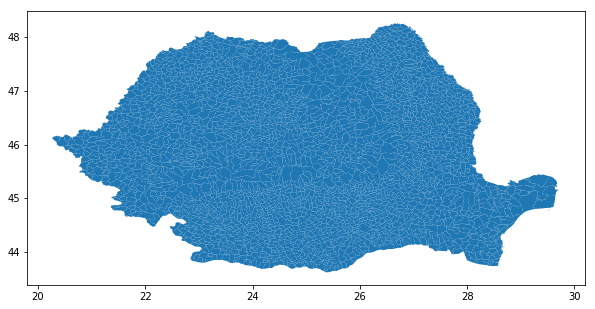

In [2]:
map_df = gpd.read_file("./gadm36_ROU.gpkg")
map_df.plot(figsize=(10, 10))

Reading the data

In [3]:
df_evolution_by_counties = pd.read_parquet("./_data/df_evolution_by_counties.parquet").reset_index().drop(columns=['SR'])
df_evolution_by_counties.head()

Judet,hour,minute,second,AB,AG,AR,B,BC,BH,BN,...,SB,SJ,SM,SV,TL,TM,TR,VL,VN,VS
0,10,1,40,0.074609,0.079700,0.060001,0.068346,0.065994,0.063351,0.061316,...,0.078966,0.076323,0.052517,0.056911,0.091122,0.067149,0.100931,0.084467,0.076902,0.061789
1,10,1,51,0.074609,0.079700,0.060001,0.068346,0.065994,0.063351,0.061316,...,0.078966,0.076323,0.052517,0.056911,0.091122,0.067149,0.100931,0.084467,0.076902,0.061789
2,10,2,2,0.074609,0.079700,0.060001,0.068346,0.065994,0.063351,0.061316,...,0.078966,0.076323,0.052517,0.056911,0.091122,0.067149,0.100931,0.084467,0.076902,0.061789
3,10,5,38,0.076429,0.082003,0.061809,0.070319,0.067906,0.064865,0.062843,...,0.081289,0.078756,0.054080,0.058330,0.093350,0.069143,0.103491,0.086822,0.079189,0.063419
4,10,6,49,0.077524,0.083609,0.062937,0.071676,0.069302,0.065730,0.064291,...,0.082752,0.080276,0.055226,0.059265,0.094827,0.070543,0.105136,0.088416,0.080722,0.064524


The names of counties from the map doesn't correspond to the names of counties in our dataset so we have to do a manual alignment.

In [31]:
mapping = {'Alba': 'AB','Arad': 'AR','Argeș': 'AG','Bacău': 'BC','Bihor': 'BH','Bistrița-Năsăud': 'BN', 'Botoșani': 'BT','Brașov': 'BV','Brăila': 'BR','Bucharest': 'B','Buzău': 'BZ','Călărași': 'CL','Caraș-Severin': 'CS','Cluj': 'CJ','Constanța': 'CT','Covasna': 'CV','Dâmbovița': 'DB','Dolj': 'DJ','Galați': 'GL','Giurgiu': 'GR','Gorj': 'GJ','Harghita': 'HR','Hunedoara': 'HD','Iași': 'IS','Ialomița': 'IL','Ilfov': 'IF','Maramureș': 'MM','Mehedinți': 'MH','Mureș': 'MS','Neamț': 'NT','Olt': 'OT','Prahova': 'PH','Sălaj': 'SJ','Satu Mare': 'SM','Sibiu': 'SB','Suceava': 'SV','Teleorman': 'TR','Timiș': 'TM','Tulcea': 'TL','Vâlcea': 'VL','Vaslui': 'VS','Vrancea': 'VN',}
map_df['JUDET'] = [mapping[name] for name in map_df['NAME_1']]

We will group all the regions of the map into counties.

In [9]:
romania_by_county = map_df[['JUDET', 'geometry']].dissolve(by="JUDET", aggfunc='sum')

In [11]:
counties = sorted(mapping.values())
def get_data(i):
    """
    Getting one row of data
    """
    percentages = df_evolution_by_counties.iloc[i][counties].values
    hour, minute = df_evolution_by_counties.iloc[i][['hour', 'minute']].astype(int).values
    return hour, minute, percentages

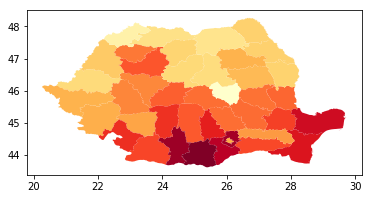

In [12]:
percentages = df_evolution_by_counties.iloc[0][counties].values
romania_by_county['percentages'] = percentages
romania_by_county.plot(column='percentages', cmap='YlOrRd')

In [13]:
def get_min_max_values():
    """
    Compute the min percentage and max percenage from all timesteps.
    This will be usefull when we want to scale the color map into an expected range of values
    and thus, make the animation frames relative in time to the previous ones.
    """
    vmin, vmax = df_evolution_by_counties[counties].values.min(), df_evolution_by_counties[counties].values.max()
    return vmin, vmax

vmin, vmax = get_min_max_values()
vmin, vmax

(0.04721114765792217, 0.6431399794209545)

## Attendance by counties

Quickly see what the attendance map looked like when we begun recording the data and how it looked at the end of the polling day.

In [149]:
from matplotlib import animation, rc
from IPython.display import HTML
from mpl_toolkits.axes_grid1 import make_axes_locatable

def init(i_init=0, vmin=None, vmax=None, title=None, subtitle=None, color=None):
    fig, ax = plt.subplots(1, 1, figsize=(12, 8))
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("left", size="1%", pad=-0.1)
    
    if not color:
        color = 'YlGnBu'
    
    if not title:
        title = 'Attendance 1st round of the presidential election'
        
    if not subtitle:
        subtitle = 'By Counties'

    hour, minute, percentages = get_data(i_init)
    romania_by_county['percentages'] = percentages
    romania_by_county.plot(
        column='percentages', 
        cmap=color, 
        ax=ax, 
        legend=True, 
        cax=cax, 
        vmin=vmin, 
        vmax=vmax, 
        legend_kwds={
            'ticks': []
    })
        
    hour_string = f"{hour}:{minute}" if minute > 9 else f"{hour}:0{minute}"
    ax.text(1, 0.9, hour_string, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)

    ax.text(0, 1.12, title, transform=ax.transAxes, size=24, weight=600, ha='left')
    ax.text(0, 1.06, subtitle, transform=ax.transAxes, size=12, color='#777777')
    ax.text(1, 0, 'credit www.clungu.com', transform=ax.transAxes, ha='right',
            color='#777777', bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'))
    
    
    romania_by_county.apply(
        lambda x: ax.annotate(
            s=f"{np.round(x.percentages*100, 2)}%", 
            xy=x.geometry.centroid.coords[0], 
            ha='center',
            color='#CCCCCC',
            size=12,
            weight=600
        ),
        axis=1
    )
    
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis('off')
    
    plt.box(False)
    fig.tight_layout()
    return fig, ax, cax

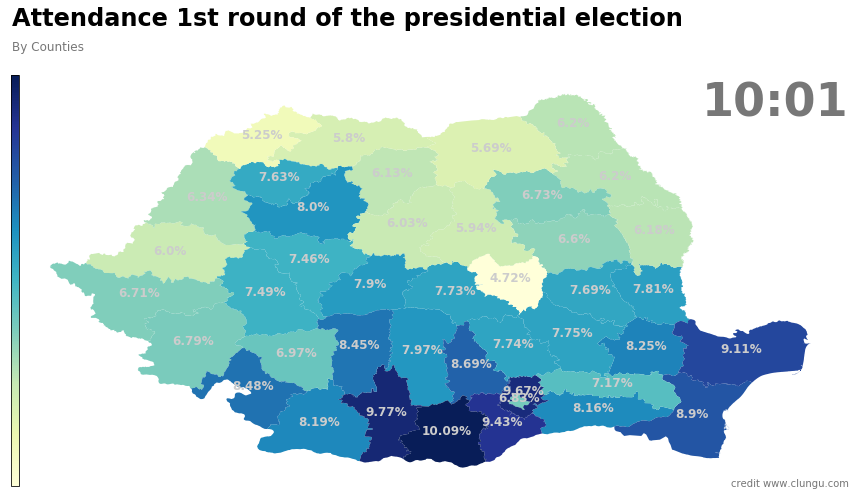

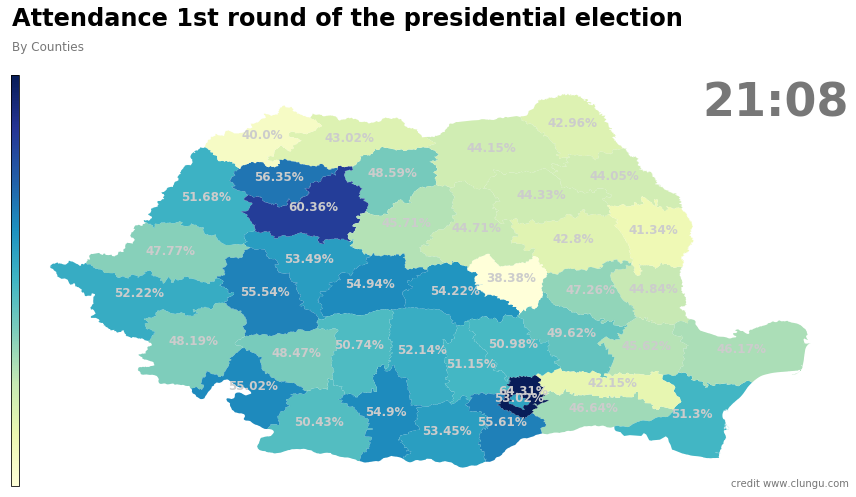

In [150]:
first = 0
last = df_evolution_by_counties.shape[0]-1

init(first,color="YlGnBu");plt.show();
init(last,color="YlGnBu");plt.show();

And the animation of all the frames in-between is:

In [ ]:
def animate(i, ax, cax, vmin=None, vmax=None, title=None, subtitle=None, show_percentages=False, total_frames=None, color=None, description=None):
    ax.clear()
    cax.clear()
    
    hour, minute, percentages = get_data(i)
    romania_by_county['percentages'] = percentages
    
    if not color:
        color = 'YlGnBu'
    
    romania_by_county.plot(
        column='percentages', 
        cmap=color, 
        ax=ax, 
        legend=True, 
        cax=cax, 
        vmin=vmin, 
        vmax=vmax, 
        legend_kwds={
            'ticks': []
    })

    if not title:
        title = 'Presidentital Elections (1st) 10.11.2019'
        
    if not subtitle:
        subtitle = 'By Counties'
        
    hour_string = f"{hour}:{minute}" if minute > 9 else f"{hour}:0{minute}"
    ax.text(1, 0.9, hour_string, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    
    ax.text(0, 1.12, title, transform=ax.transAxes, size=24, weight=600, ha='left')
    ax.text(0, 1.06, subtitle, transform=ax.transAxes, size=12, color='#777777')
    ax.text(1, 0, 'credit www.clungu.com', transform=ax.transAxes, ha='right',
            color='#777777', bbox=dict(facecolor='white', alpha=0.8, edgecolor='white'))
        
    if description:
        ax.text(0.2, -0.1, description, transform=ax.transAxes, ha='left',
                color='#777777', bbox=dict(facecolor='white', alpha=1, edgecolor='white'))
    
    
    is_last_frame = i == total_frames - 1
    if show_percentages or is_last_frame:
        romania_by_county.apply(
            lambda x: ax.annotate(
                s=f"{int(np.round(x.percentages*100, 0))}%", 
                xy=x.geometry.centroid.coords[0], 
                ha='center',
                color='#CCCCCC',
                size=12,
                weight=600
            ),
            axis=1
        )
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis('off')
    plt.box(False)

vmin, vmax = get_min_max_values()
vmin, vmax = None, None
frames = 30
color = None
description = '''
This is a very long explanation of what you see on the screen. 
It should be multiline but I\'m unsure if the library knows how to wrap'''


fig, ax, cax = init(vmin=vmin, vmax=vmax)
anim = animation.FuncAnimation(fig, animate, fargs=(ax, cax, vmin, vmax, None, None, True, frames, color, description), frames=frames, interval=50, blit=False)
display(HTML(anim.to_html5_video()))
plt.close()

In [28]:
vmin, vmax = get_min_max_values()
title, subtitle = None, "Attendance by counties"
frames = df_evolution_by_counties.shape[0]
color = None
show_percentages=True
description = None


fig, ax, cax = init(vmin=vmin, vmax=vmax)
anim = animation.FuncAnimation(fig, animate, fargs=(ax, cax, vmin, vmax, title, subtitle, show_percentages, frames, color, description), frames=frames, interval=50, blit=False)
display(HTML(anim.to_html5_video()))
plt.close()

## Choropleth race of counties

One interesting thing to do now is combine a choropleth (map chart) with the bar plot race idea. We will build an animation what will show **at each moment in time** the **ranking** of counties.

Some counties will start at the top of the rankings (in blue) and others near the bottom (red). As time progresses and rankings change these might change places (as is happening in a bar chart race but this time one map, through colors)  

We will use the `color = 'Spectral'` [color pallete](http://www.sthda.com/english/wiki/colors-in-r) because we are looking at a divergent plot and want to emphasize on mid-range critical values and extremes at both ends of the data range. 

In [30]:
vmin, vmax = None, None
title, subtitle = None, "Race between counties"
frames = df_evolution_by_counties.shape[0]
color = 'Spectral'
show_percentages=False
description = '''
    This shows, at each moment in time, the ranking of counties by attendance. In blue are the counties 
    with the highest attendance AT THAT MOMENT (red is bottom). 
         
    It it interesting to note how some counties fall in rankins while others climb as times progresses.
'''

fig, ax, cax = init(vmin=vmin, vmax=vmax)
anim = animation.FuncAnimation(fig, animate, fargs=(ax, cax, vmin, vmax, title, subtitle, show_percentages, frames, color, description), frames=frames, interval=50, blit=False)
display(HTML(anim.to_html5_video()))
plt.close()

Possible conclusions can draw:
* Southern counties began in a really high attendance
* North-Eastern and eastern counties didn't bother much with voting throughout the day.
* large Hungarian minority counties (SM, CV) were constant at the bottom of the ranking.
* MH, HD, TR, OT started the day really strong and even though lost some positions by the end of the day, were still on top.
* CJ came really fast behind ending in second place.
* TM, IS, B, BH, CT (with large student population and university centers) performed average or worse